<a href="https://colab.research.google.com/github/Helothlad/Menorca-Biodiversity-Optimization/blob/main/Final_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img align="left" width="30%" src="https://www.upv.es/entidades/etsinf/wp-content/uploads/2024/06/logo_etsinf_valenciano_grisUPV.svg"/> <img width="30%" src="https://www.upv.es/perfiles/pas-pdi/imagenes/marca_UPV_principal_negro150.png" align="right"/>

# Optimization: Project I 2025

In [ ]:
import folium
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.colors import rgb2hex
import numpy as np

In [ ]:

import folium
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.colors import rgb2hex
import numpy as np
import math
from ortools.sat.python import cp_model
from shapely.geometry import box
import heapq
import warnings

# 1. Defining Colors
SPECIES_COLORS = {
    'martes': '#000000',
    'eliomys': '#808080',
    'oryctolagus': '#0000FF',
    'atelerix': '#633200',
    'none': '#FF0000',
    'corridor': '#FFFFFF'
}

# 2. Visualization Function

def visualize_initial_map(gdf):
    """
    Creates a single, general Folium map using HORIZONTAL STRIPES
    to show the INITIAL co-habitation.
    """

    # Define species and their corresponding columns
    species_map = {
        'atelerix': 'has_atelerix_algirus',
        'martes': 'has_martes_martes',
        'eliomys': 'has_eliomys_quercinus',
        'oryctolagus': 'has_oryctolagus_cuniculus'
    }

    print("Generating striped initial co-habitation map...")

    m = folium.Map(
        location=[39.97, 4.0460],
        zoom_start=11,
        tiles='CartoDB positron',
        width="60%"
    )

    # Loop over every cell in the GeoDataFrame
    for _, row in gdf.iterrows():
        c_id = row['grid_id']
        geom = row.geometry

        # 1. Find all species present in this cell
        species_in_this_cell = []
        for species_name, col_name in species_map.items():
            if row[col_name]:
                species_in_this_cell.append(species_name)

        # 2. Build the tooltip
        tooltip_html = f"""
            <b>Grid ID:</b> {row['grid_id']}<br>
            <b>Land Cover:</b> {row['dominant_land_cover_name']}<br>
            <hr>
        """
        if not species_in_this_cell:
            tooltip_html += "<b>No Initial Habitat</b>"
        else:
            species_names_html = "<br>".join([s.title() for s in species_in_this_cell])
            tooltip_html += f"<b>{len(species_in_this_cell)} Species Present:</b><br>{species_names_html}"

        # 3. Add cell to map

        # CASE 1: No species (Red)
        if not species_in_this_cell:
            folium.GeoJson(
                geom,
                style_function=lambda x: {
                    'fillColor': SPECIES_COLORS['none'],
                    'color': 'black', 'weight': 0.5, 'fillOpacity': 0.4
                },
                tooltip=tooltip_html
            ).add_to(m)

        # CASE 2: Exactly one species (Solid)
        elif len(species_in_this_cell) == 1:
            color = SPECIES_COLORS[species_in_this_cell[0]]
            folium.GeoJson(
                geom,
                style_function=lambda x, c=color: {
                    'fillColor': c, 'color': 'black', 'weight': 0.5, 'fillOpacity': 0.7
                },
                tooltip=tooltip_html
            ).add_to(m)

        # CASE 3: Multiple species (Striped)
        else:
            minx, miny, maxx, maxy = geom.bounds
            num_bands = len(species_in_this_cell)
            band_height = (maxy - miny) / num_bands

            for i, species_name in enumerate(species_in_this_cell):
                color = SPECIES_COLORS[species_name]
                b_miny = miny + (i * band_height)
                b_maxy = miny + ((i + 1) * band_height)
                band = box(minx, b_miny, maxx, b_maxy)
                stripe_geom = geom.intersection(band)

                folium.GeoJson(
                    stripe_geom,
                    style_function=lambda x, c=color: {
                        'fillColor': c, 'color': 'black', 'weight': 0.1, 'fillOpacity': 0.7
                    },
                    tooltip=tooltip_html
                ).add_to(m)

            folium.GeoJson(
                geom,
                style_function=lambda x: {
                    'fillOpacity': 0.0, 'color': 'black', 'weight': 0.5
                },
                tooltip=tooltip_html
            ).add_to(m)

    # 4. Add Legend
    legend_html = f'''
     <div style="position: fixed;
     bottom: 50px; left: 50px; width: 200px; height: 160px;
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color: white; padding: 10px;
     ">
     <b>Species Legend</b><br>
     <i style="background:{SPECIES_COLORS['martes']}; border: 1px solid black;">&nbsp;&nbsp;&nbsp;&nbsp;</i>&nbsp; Martes<br>
     <i style="background:{SPECIES_COLORS['eliomys']}; border: 1px solid black;">&nbsp;&nbsp;&nbsp;&nbsp;</i>&nbsp; Eliomys<br>
     <i style="background:{SPECIES_COLORS['oryctolagus']}; border: 1.5px solid black;">&nbsp;&nbsp;&nbsp;&nbsp;</i>&nbsp; Oryctolagus<br>
     <i style="background:{SPECIES_COLORS['atelerix']}; border: 1px solid black;">&nbsp;&nbsp;&nbsp;&nbsp;</i>&nbsp; Atelerix<br>
     <i style="background:{SPECIES_COLORS['none']}; opacity: 0.5; border: 1px solid black;">&nbsp;&nbsp;&nbsp;&nbsp;</i>&nbsp; No Habitat Cell<br>
     </div>
     '''

    m.get_root().html.add_child(folium.Element(legend_html))
    return m

# 3. Main Execution Block

# Suppress pandas warnings
warnings.filterwarnings('ignore', message='.*Shapely 2.0.*')

print("---  Downloading Data... ---")
#  force download the file
!wget -q -O dataset.geojson "https://gitlab.com/drvicsana/opt-milp-project-2025/-/raw/main/datasets/dataset.geojson"

print("---  Loading Data and Generating Initial Map ---")
#  read the file from the local Colab session
try:
    dataset_gpd = gpd.read_file("dataset.geojson")

    initial_map = visualize_initial_map(dataset_gpd)

    display(initial_map)

except Exception as e:
    print(f"Error reading file or generating map: {e}")
    print("Please check that the file 'dataset.geojson' was downloaded correctly.")

--- 🏁 Downloading Data... ---
--- 🗺️ Loading Data and Generating Initial Map ---
Generating striped initial co-habitation map...


In [ ]:
#MODEL 7
import folium
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import math
from ortools.linear_solver import pywraplp
from shapely.geometry import box
import warnings
import collections


# Global constants

SPECIES_COLORS = {
    'martes': '#000000', 'eliomys': '#808080', 'oryctolagus': '#0000FF',
    'atelerix': '#633200', 'none': '#FF0000', 'corridor': '#00FF00'
}
GLOBAL_BUDGET = 260.0
MAX_EXPANSION_LAYERS = 6  # LIMIT SEARCH TO 6 STEPS FROM EXISTING POPULATION

# Helper functions

def find_neighbors(gdf):
    print("Finding neighbors...")
    neighbors_map = {}
    spatial_index = gdf.sindex
    for idx, row in gdf.iterrows():
        gid = row['grid_id']
        bounds = row.geometry.bounds
        possible_idx = list(spatial_index.intersection(bounds))
        possible = gdf.iloc[possible_idx]
        precise = possible[possible.geometry.intersects(row.geometry)]
        neighbors = precise[precise['grid_id'] != gid]['grid_id'].tolist()
        neighbors_map[gid] = neighbors
    return neighbors_map

def preprocess_data(gdf):
    print("Preprocessing data...")
    species_list = ['atelerix', 'martes', 'eliomys', 'oryctolagus']
    # 0.1 = Perfect, 1.0 = Impossible
    suitability_map = {
        'atelerix': { 'Pastures': 0.1, 'Non-irrigated Arable Land': 0.1, 'Complex Cultivation Patterns': 0.1, 'Sclerophyllous Vegetation': 0.1, 'Transitional Woodland-Shrub': 0.1, 'Discontinuous Urban Fabric': 0.5, 'Natural Grasslands': 0.5, 'Broad-leaved Forests': 0.5, 'Mixed Forests': 0.5, 'Permanently Irrigated Land': 0.8, 'Coniferous Forests': 0.8, 'Continuous Urban Fabric': 1.0, 'Industrial or Commercial Units': 1.0, 'Airports': 1.0, 'Port Areas': 1.0, 'Sport and Leisure Facilities': 1.0, 'Peatbogs': 1.0, 'Inland Marshes': 1.0, 'Coastal Lagoons': 1.0, 'Estuaries': 1.0, 'Intertidal Flats': 1.0, 'Water Courses': 1.0 },
        'martes':   { 'Sclerophyllous Vegetation': 0.1, 'Transitional Woodland-Shrub': 0.1, 'Broad-leaved Forests': 0.1, 'Mixed Forests': 0.1, 'Agriculture with Natural Vegetation': 0.1, 'Coniferous Forests': 0.5, 'Complex Cultivation Patterns': 0.5, 'Discontinuous Urban Fabric': 0.8, 'Pastures': 0.8, 'Non-irrigated Arable Land': 0.8, 'Natural Grasslands': 0.8, 'Continuous Urban Fabric': 1.0, 'Industrial or Commercial Units': 1.0, 'Airports': 1.0, 'Port Areas': 1.0, 'Sport and Leisure Facilities': 1.0, 'Permanently Irrigated Land': 1.0, 'Peatbogs': 1.0, 'Inland Marshes': 1.0, 'Coastal Lagoons': 1.0, 'Estuaries': 1.0, 'Intertidal Flats': 1.0, 'Water Courses': 1.0 },
        'eliomys':  { 'Sclerophyllous Vegetation': 0.1, 'Transitional Woodland-Shrub': 0.1, 'Broad-leaved Forests': 0.1, 'Mixed Forests': 0.1, 'Complex Cultivation Patterns': 0.5, 'Agriculture with Natural Vegetation': 0.5, 'Coniferous Forests': 0.5, 'Discontinuous Urban Fabric': 0.8, 'Continuous Urban Fabric': 1.0, 'Industrial or Commercial Units': 1.0, 'Airports': 1.0, 'Port Areas': 1.0, 'Sport and Leisure Facilities': 1.0, 'Pastures': 1.0, 'Non-irrigated Arable Land': 1.0, 'Permanently Irrigated Land': 1.0, 'Natural Grasslands': 1.0, 'Peatbogs': 1.0, 'Inland Marshes': 1.0, 'Coastal Lagoons': 1.0, 'Estuaries': 1.0, 'Intertidal Flats': 1.0, 'Water Courses': 1.0 },
        'oryctolagus': { 'Pastures': 0.1, 'Non-irrigated Arable Land': 0.1, 'Complex Cultivation Patterns': 0.1, 'Agriculture with Natural Vegetation': 0.1, 'Sclerophyllous Vegetation': 0.1, 'Transitional Woodland-Shrub': 0.1, 'Natural Grasslands': 0.1, 'Broad-leaved Forests': 0.5, 'Mixed Forests': 0.5, 'Discontinuous Urban Fabric': 0.8, 'Permanently Irrigated Land': 0.8, 'Coniferous Forests': 0.8, 'Continuous Urban Fabric': 1.0, 'Industrial or Commercial Units': 1.0, 'Airports': 1.0, 'Port Areas': 1.0, 'Sport and Leisure Facilities': 1.0, 'Peatbogs': 1.0, 'Inland Marshes': 1.0, 'Coastal Lagoons': 1.0, 'Estuaries': 1.0, 'Intertidal Flats': 1.0, 'Water Courses': 1.0 }
    }

    cells = gdf['grid_id'].tolist()
    parameters = {
        'initial': {}, 'cost_exp': {}, 'suitability': {}, 'usable': {},
        'neighbors': find_neighbors(gdf), 'cost_corridor': {}
    }
    species_cols = {
        'atelerix': ('has_atelerix_algirus', 'cost_adaptation_atelerix'),
        'martes': ('has_martes_martes', 'cost_adaptation_martes'),
        'eliomys': ('has_eliomys_quercinus', 'cost_adaptation_eliomys'),
        'oryctolagus': ('has_oryctolagus_cuniculus', 'cost_adaptation_oryctolagus')
    }
    for _, row in gdf.iterrows():
        cid = row['grid_id']
        land = row.get('dominant_land_cover_name', None)
        parameters['cost_corridor'][cid] = float(row.get('cost_corridor', 0.0))
        for s in species_list:
            has_col, cost_col = species_cols[s]
            parameters['initial'][(cid, s)] = int(row.get(has_col, 0))
            parameters['cost_exp'][(cid, s)] = float(row.get(cost_col, 0.0))
            score = suitability_map[s].get(land, 1.0)
            parameters['suitability'][(cid, s)] = float(score)
            parameters['usable'][(cid, s)] = 1 if score < 1.0 else 0
    #parameters['targets'] = {'atelerix': 3.0, 'martes': 2.0, 'eliomys': 4.0, 'oryctolagus': 5.0}
    # Reduced targets to ensure feasibility
    parameters['targets'] = {'atelerix': 2.0, 'martes': 1.5, 'eliomys': 2.0, 'oryctolagus': 2.0}
    return cells, species_list, parameters


# SEARCH SPACE PRUNING

def get_pruned_candidates(cells, species_list, parameters, layers=4):
    """
    Returns a dict {species: set(candidate_cells)}.
    Only includes cells that are within 'layers' steps of an initial population.
    This drastically reduces variable count.
    """
    print(f"Pruning search space (Max {layers} layers from existing)...")
    pruned = {}

    for s in species_list:
        # 1. Start with initial cells
        current_layer = set([c for c in cells if parameters['initial'][(c, s)] == 1])
        visited = set(current_layer)
        valid_candidates = set()

        # 2. Expand outwards BFS
        for _ in range(layers):
            next_layer = set()
            for c in current_layer:
                neighbors = parameters['neighbors'].get(c, [])
                for n in neighbors:
                    if n not in visited:
                        visited.add(n)
                        # Only add if it's biologically usable
                        if parameters['usable'][(n, s)] == 1:
                            valid_candidates.add(n)
                            next_layer.add(n)
            current_layer = next_layer
            if not current_layer: break

        pruned[s] = valid_candidates
        print(f"  Species {s}: Reduced candidates from ~{len(cells)} to {len(valid_candidates)}")

    return pruned


# PRUNED FLOW MODEL

def solve_pruned_flow_model(cells, species_list, parameters, budget_limit):
    print(f"\n--- Starting Pruned Flow Optimization (Budget: {budget_limit}) ---")

    # 1. Prune Candidates
    candidates_per_species = get_pruned_candidates(cells, species_list, parameters, layers=MAX_EXPANSION_LAYERS)

    solver = pywraplp.Solver.CreateSolver('SCIP')
    if not solver: solver = pywraplp.Solver.CreateSolver('SCIP')
    solver.EnableOutput()
    solver.set_time_limit(900000) # 5 minutes should be enough for pruned model

    # 2. Variables
    x = {}
    f = {}
    TotNew = {}

    initial_counts = {s: 0 for s in species_list}
    target_counts = {}
    M = len(cells) # Big M

    for s in species_list:
        count = sum(parameters['initial'][(c, s)] for c in cells)
        initial_counts[s] = count
        target_counts[s] = math.ceil(count * parameters['targets'][s])

    # Initialize x variables ONLY for Pruned Candidates
    print("  Initializing variables...")
    for s in species_list:
        for c in candidates_per_species[s]:
             x[c, s] = solver.BoolVar(f'x_{c}_{s}')

    # 3. Flow Network (Restricted)
    print("  Building reduced flow network...")
    for s in species_list:
        initial_nodes = [c for c in cells if parameters['initial'][(c, s)] == 1]
        if not initial_nodes: continue

        # Network = Initial + Pruned Candidates
        nodes_s = set(initial_nodes) | candidates_per_species[s]

        TotNew[s] = solver.IntVar(0, len(nodes_s), f'TotNew_{s}')

        # Edges
        for i in nodes_s:
            for j in parameters['neighbors'].get(i, []):
                if j in nodes_s:
                    f[i, j, s] = solver.NumVar(0.0, float(M), f'f_{i}_{j}_{s}')

        # Root edges
        root_name = f'root_{s}'
        for k in initial_nodes:
            f[root_name, k, s] = solver.NumVar(0.0, float(M), f'f_root_{k}_{s}')

    # 4. Objective
    objective = solver.Objective()
    for (c, s), var in x.items():
        cost = parameters['cost_exp'][(c, s)]
        suit = parameters['suitability'][(c, s)]
        objective.SetCoefficient(var, cost * suit)
    objective.SetMinimization()

    # 5. Constraints

    # A) Targets
    for s in species_list:
        needed = target_counts[s] - initial_counts[s]
        if needed > 0:
            solver.Add(sum(x[c, s] for c in candidates_per_species[s]) >= needed)

    # B) Budget
    solver.Add(sum(parameters['cost_exp'][(c, s)] * x[c, s] for (c, s) in x) <= budget_limit)

    # C) Predator-Prey (On pruned set)
    prey_species = ['eliomys', 'oryctolagus']
    for c in cells:
        # Check if this cell is a candidate for any species involved
        relevant = False
        if parameters['initial'][(c, 'martes')] == 1: relevant = True
        elif (c, 'martes') in x: relevant = True

        if not relevant:
            # Check if relevant for prey
            for p in prey_species:
                if parameters['initial'][(c, p)] == 1 or (c, p) in x:
                    relevant = True
                    break

        if relevant:
            init_martes = parameters['initial'][(c, 'martes')]
            for prey in prey_species:
                init_prey = parameters['initial'][(c, prey)]
                if init_martes == 1 and init_prey == 1: continue

                if init_martes == 1:
                    if (c, prey) in x: solver.Add(x[c, prey] == 0)
                elif init_prey == 1:
                    if (c, 'martes') in x: solver.Add(x[c, 'martes'] == 0)
                elif init_martes == 0 and init_prey == 0:
                    if (c, 'martes') in x and (c, prey) in x:
                        solver.Add(x[c, 'martes'] + x[c, prey] <= 1)

    # D) Flow Constraints (Connectivity)
    print("  Adding flow constraints...")
    for s in species_list:
        initial_nodes = [c for c in cells if parameters['initial'][(c, s)] == 1]
        if not initial_nodes: continue

        nodes_s = set(initial_nodes) | candidates_per_species[s]
        root_name = f'root_{s}'

        # Link TotNew
        if candidates_per_species[s]:
            solver.Add(TotNew[s] == sum(x[c, s] for c in candidates_per_species[s]))
        else:
            solver.Add(TotNew[s] == 0)

        # Root Outflow
        root_outs = [f[root_name, k, s] for k in initial_nodes if (root_name, k, s) in f]
        if root_outs:
            solver.Add(sum(root_outs) == TotNew[s])

        # Flow Balance & Capacity
        for i in nodes_s:
            inflows = []
            outflows = []

            # Neighbors
            for j in parameters['neighbors'].get(i, []):
                if (j, i, s) in f: inflows.append(f[j, i, s])
                if (i, j, s) in f: outflows.append(f[i, j, s])

            # Root
            if (root_name, i, s) in f: inflows.append(f[root_name, i, s])

            # Balance
            if parameters['initial'][(i, s)] == 1:
                solver.Add(sum(inflows) - sum(outflows) == 0)
            else:
                solver.Add(sum(inflows) - sum(outflows) == x[i, s])

            # Capacity Coupling (The Pipe Logic)
            for j in parameters['neighbors'].get(i, []):
                if (i, j, s) in f:
                    if parameters['initial'][(j, s)] == 1:
                        solver.Add(f[i, j, s] <= M)
                    elif (j, s) in x:
                        solver.Add(f[i, j, s] <= M * x[j, s])
                    else:
                        solver.Add(f[i, j, s] <= 0)

    # 6. Solve
    print("Solving Pruned ILP...")
    status = solver.Solve()

    results_dict = {}
    grand_total_cost = 0.0

    if status in [pywraplp.Solver.OPTIMAL, pywraplp.Solver.FEASIBLE]:
        print("\nSuccess: Solution found!")
        print("\nSummary:")
        print(f"{'Species':<12} | {'Initial':<7} | {'New':<5} | {'Final Total':<11} | {'Cost (€)':<12}")
        print("-" * 70)

        for s in species_list:
            new_count = 0
            species_cost = 0.0
            for c in cells:
                is_init = parameters['initial'][(c, s)]
                is_new = 0
                if (c, s) in x and x[c, s].solution_value() > 0.5:
                    is_new = 1

                results_dict[(c, s)] = 1 if (is_init or is_new) else 0
                if is_new:
                    new_count += 1
                    species_cost += parameters['cost_exp'][(c, s)]

            grand_total_cost += species_cost
            print(f"{s.title():<12} | {initial_counts[s]:<7} | {new_count:<5} | {initial_counts[s]+new_count:<11} | €{species_cost:,.2f}")

        print("-" * 70)
        print(f"TOTAL COST: €{grand_total_cost:,.2f}")
        return results_dict, status
    else:
        print(f"No solution found. Status: {status}")
        return {}, status


# Visualization

def visualize_striped_map(gdf, initial_data, results_dict, corridor_cells=None):
    species_list = ['atelerix', 'martes', 'eliomys', 'oryctolagus']
    if corridor_cells is None: corridor_cells = set()
    print("Generating map...")
    try:
        centroid = gdf.geometry.union_all().centroid
        center = [centroid.y, centroid.x]
    except:
        center = [39.97, 4.0460]
    m = folium.Map(location=center, zoom_start=11, tiles='CartoDB positron', width="60%")
    for _, row in gdf.iterrows():
        c_id = row['grid_id']
        geom = row.geometry
        if c_id in corridor_cells:
            folium.GeoJson(geom, style_function=lambda x: {'fillColor': SPECIES_COLORS['corridor'], 'color': 'black', 'weight': 0.5, 'fillOpacity': 0.8}, tooltip=f"CORRIDOR {c_id}").add_to(m)
            continue
        species_in_this_cell = []
        for s in species_list:
            if results_dict.get((c_id, s), 0) == 1: species_in_this_cell.append(s)
        tooltip_html = f"Grid: {c_id}<br>Type: {row.get('dominant_land_cover_name')}<hr>"
        if species_in_this_cell:
            names = "<br>".join([s.title() for s in species_in_this_cell])
            tooltip_html += f"<b>Present:</b><br>{names}"
        if not species_in_this_cell:
            folium.GeoJson(geom, style_function=lambda x: {'fillColor': SPECIES_COLORS['none'], 'color': 'black', 'weight': 0.5, 'fillOpacity': 0.4}, tooltip=tooltip_html).add_to(m)
        elif len(species_in_this_cell) == 1:
            c = SPECIES_COLORS[species_in_this_cell[0]]
            folium.GeoJson(geom, style_function=lambda x, c=c: {'fillColor': c, 'color': 'black', 'weight': 0.5, 'fillOpacity': 0.7}, tooltip=tooltip_html).add_to(m)
        else:
            minx, miny, maxx, maxy = geom.bounds
            num_bands = len(species_in_this_cell)
            band_height = (maxy - miny) / num_bands if num_bands > 0 else 0
            for i, species_name in enumerate(species_in_this_cell):
                c = SPECIES_COLORS[species_name]
                b_miny = miny + (i * band_height)
                b_maxy = miny + ((i + 1) * band_height)
                band = box(minx, b_miny, maxx, b_maxy)
                stripe_geom = geom.intersection(band)
                if not stripe_geom.is_empty:
                    folium.GeoJson(stripe_geom, style_function=lambda x, c=c: {'fillColor': c, 'color': 'black', 'weight': 0.1, 'fillOpacity': 0.7}, tooltip=tooltip_html).add_to(m)
            folium.GeoJson(geom, style_function=lambda x: {'fillOpacity': 0.0, 'color': 'black', 'weight': 0.5}, tooltip=tooltip_html).add_to(m)
    legend_html = f'''<div style="position: fixed; bottom: 50px; left: 50px; width: 160px; background-color: white; padding: 10px; border:2px solid grey; z-index:9999;"><b>Legend</b><br>'''
    if corridor_cells: legend_html += f'<i style="background:{SPECIES_COLORS["corridor"]};">&nbsp;&nbsp;</i> Corridor<br>'
    for s in species_list: legend_html += f'<i style="background:{SPECIES_COLORS[s]};">&nbsp;&nbsp;</i> {s.title()}<br>'
    legend_html += '</div>'
    m.get_root().html.add_child(folium.Element(legend_html))
    return m

# Main

if __name__ == '__main__':
    warnings.filterwarnings('ignore')
    print("--- Loading data ---")
    try:
        dataset_gpd = gpd.read_file("dataset.geojson")
    except:
        dataset_gpd = gpd.read_file("https://gitlab.com/drvicsana/opt-milp-project-2025/-/raw/main/datasets/dataset.geojson")

    cells, species, model_params = preprocess_data(dataset_gpd)
    results_dict, status = solve_pruned_flow_model(cells, species, model_params, GLOBAL_BUDGET)

    if status == pywraplp.Solver.OPTIMAL or status == pywraplp.Solver.FEASIBLE:
        print("\n--- Generating Map ---")
        stage1_map = visualize_striped_map(dataset_gpd, model_params['initial'], results_dict, corridor_cells=None)
        try:
            from IPython.display import display
            display(stage1_map)
        except Exception:
            stage1_map.save("pruned_flow_map.html")
            print("Map saved to pruned_flow_map.html")

--- Loading data ---
Preprocessing data...
Finding neighbors...

--- Starting Pruned Flow Optimization (Budget: 260.0) ---
Pruning search space (Max 6 layers from existing)...
  Species atelerix: Reduced candidates from ~1401 to 970
  Species martes: Reduced candidates from ~1401 to 772
  Species eliomys: Reduced candidates from ~1401 to 577
  Species oryctolagus: Reduced candidates from ~1401 to 1028
  Initializing variables...
  Building reduced flow network...
  Adding flow constraints...
Solving Pruned ILP...

Success: Solution found!

Summary:
Species      | Initial | New   | Final Total | Cost (€)    
----------------------------------------------------------------------
Atelerix     | 24      | 24    | 48          | €27.31
Martes       | 11      | 6     | 17          | €6.20
Eliomys      | 20      | 20    | 40          | €22.59
Oryctolagus  | 16      | 16    | 32          | €16.79
----------------------------------------------------------------------
TOTAL COST: €72.89

--- Gene

In [ ]:
import folium
import pandas as pd
import geopandas as gpd
import math
import warnings
from ortools.linear_solver import pywraplp
from shapely.geometry import box


# 1. CONFIGURATION

GLOBAL_BUDGET = 260.0
MAX_EXPANSION_LAYERS = 12  # Limits expansion to 6 steps from existing colonies

# ORIGINAL COLOR MAPPING
SPECIES_COLORS = {
    'martes': '#000000',      # Black
    'eliomys': '#808080',     # Grey
    'oryctolagus': '#0000FF', # Blue
    'atelerix': '#633200',    # Brown
    'none': '#FF0000',        # Red
    'corridor': '#00FF00'     # Green
}


# 2. DATA PREPROCESSING

def preprocess_data(gdf):
    print("Preprocessing data...")
    species_list = ['atelerix', 'martes', 'eliomys', 'oryctolagus']

    # 0.1 = Perfect/Cheap, 1.0 = Bad/Expensive
    suitability_map = {
        'atelerix': { 'Pastures': 0.1, 'Non-irrigated Arable Land': 0.1, 'Complex Cultivation Patterns': 0.1, 'Sclerophyllous Vegetation': 0.1, 'Transitional Woodland-Shrub': 0.1, 'Discontinuous Urban Fabric': 0.5, 'Natural Grasslands': 0.5, 'Broad-leaved Forests': 0.5, 'Mixed Forests': 0.5, 'Permanently Irrigated Land': 0.8, 'Coniferous Forests': 0.8, 'Continuous Urban Fabric': 1.0, 'Industrial or Commercial Units': 1.0, 'Airports': 1.0, 'Port Areas': 1.0, 'Sport and Leisure Facilities': 1.0, 'Peatbogs': 1.0, 'Inland Marshes': 1.0, 'Coastal Lagoons': 1.0, 'Estuaries': 1.0, 'Intertidal Flats': 1.0, 'Water Courses': 1.0 },
        'martes':   { 'Sclerophyllous Vegetation': 0.1, 'Transitional Woodland-Shrub': 0.1, 'Broad-leaved Forests': 0.1, 'Mixed Forests': 0.1, 'Agriculture with Natural Vegetation': 0.1, 'Coniferous Forests': 0.5, 'Complex Cultivation Patterns': 0.5, 'Discontinuous Urban Fabric': 0.8, 'Pastures': 0.8, 'Non-irrigated Arable Land': 0.8, 'Natural Grasslands': 0.8, 'Continuous Urban Fabric': 1.0, 'Industrial or Commercial Units': 1.0, 'Airports': 1.0, 'Port Areas': 1.0, 'Sport and Leisure Facilities': 1.0, 'Permanently Irrigated Land': 1.0, 'Peatbogs': 1.0, 'Inland Marshes': 1.0, 'Coastal Lagoons': 1.0, 'Estuaries': 1.0, 'Intertidal Flats': 1.0, 'Water Courses': 1.0 },
        'eliomys':  { 'Sclerophyllous Vegetation': 0.1, 'Transitional Woodland-Shrub': 0.1, 'Broad-leaved Forests': 0.1, 'Mixed Forests': 0.1, 'Complex Cultivation Patterns': 0.5, 'Agriculture with Natural Vegetation': 0.5, 'Coniferous Forests': 0.5, 'Discontinuous Urban Fabric': 0.8, 'Continuous Urban Fabric': 1.0, 'Industrial or Commercial Units': 1.0, 'Airports': 1.0, 'Port Areas': 1.0, 'Sport and Leisure Facilities': 1.0, 'Pastures': 1.0, 'Non-irrigated Arable Land': 1.0, 'Permanently Irrigated Land': 1.0, 'Natural Grasslands': 1.0, 'Peatbogs': 1.0, 'Inland Marshes': 1.0, 'Coastal Lagoons': 1.0, 'Estuaries': 1.0, 'Intertidal Flats': 1.0, 'Water Courses': 1.0 },
        'oryctolagus': { 'Pastures': 0.1, 'Non-irrigated Arable Land': 0.1, 'Complex Cultivation Patterns': 0.1, 'Agriculture with Natural Vegetation': 0.1, 'Sclerophyllous Vegetation': 0.1, 'Transitional Woodland-Shrub': 0.1, 'Natural Grasslands': 0.1, 'Broad-leaved Forests': 0.5, 'Mixed Forests': 0.5, 'Discontinuous Urban Fabric': 0.8, 'Permanently Irrigated Land': 0.8, 'Coniferous Forests': 0.8, 'Continuous Urban Fabric': 1.0, 'Industrial or Commercial Units': 1.0, 'Airports': 1.0, 'Port Areas': 1.0, 'Sport and Leisure Facilities': 1.0, 'Peatbogs': 1.0, 'Inland Marshes': 1.0, 'Coastal Lagoons': 1.0, 'Estuaries': 1.0, 'Intertidal Flats': 1.0, 'Water Courses': 1.0 }
    }

    cells = gdf['grid_id'].tolist()

    # Build fast neighbor lookup
    print("  Building neighbor graph...")
    neighbors_map = {}
    spatial_index = gdf.sindex
    for idx, row in gdf.iterrows():
        gid = row['grid_id']
        bounds = row.geometry.bounds
        possible_idx = list(spatial_index.intersection(bounds))
        possible = gdf.iloc[possible_idx]
        precise = possible[possible.geometry.intersects(row.geometry)]
        neighbors = precise[precise['grid_id'] != gid]['grid_id'].tolist()
        neighbors_map[gid] = neighbors

    parameters = {
        'initial': {},
        'cost_exp': {},
        'suitability': {},
        'usable': {},
        'neighbors': neighbors_map,
        'targets': {'atelerix': 2.0, 'martes': 1.5, 'eliomys': 2.5, 'oryctolagus': 3.0}
    }

    species_cols = {
        'atelerix': ('has_atelerix_algirus', 'cost_adaptation_atelerix'),
        'martes': ('has_martes_martes', 'cost_adaptation_martes'),
        'eliomys': ('has_eliomys_quercinus', 'cost_adaptation_eliomys'),
        'oryctolagus': ('has_oryctolagus_cuniculus', 'cost_adaptation_oryctolagus')
    }

    for _, row in gdf.iterrows():
        cid = row['grid_id']
        land = row.get('dominant_land_cover_name', None)

        for s in species_list:
            has_col, cost_col = species_cols[s]

            parameters['initial'][(cid, s)] = int(row.get(has_col, 0))
            parameters['cost_exp'][(cid, s)] = float(row.get(cost_col, 0.0))

            score = suitability_map[s].get(land, 1.0)
            parameters['suitability'][(cid, s)] = float(score)
            parameters['usable'][(cid, s)] = 1 if score < 1.0 else 0

    return cells, species_list, parameters

# ----------------------------
# 3. BFS LAYER GENERATION (The "Onion" Logic)
# ----------------------------
def get_expansion_layers(cells, species_list, parameters, max_layers):
    """
    Creates the dependency tree: Layer 2 depends on Layer 1, Layer 1 depends on Layer 0.
    """
    print(f"Generating expansion layers (Max {max_layers} steps)...")
    layered_structure = {s: [] for s in species_list}

    for s in species_list:
        # Layer 0: Existing populations
        layer_0 = set([c for c in cells if parameters['initial'][(c, s)] == 1])
        visited = set(layer_0)
        previous_layer = layer_0

        for i in range(max_layers):
            current_layer_data = {} # {child: [parents]}

            for parent in previous_layer:
                neighbors = parameters['neighbors'].get(parent, [])

                for child in neighbors:
                    # 1. Biologically suitable?
                    if parameters['usable'][(child, s)] == 1:
                        # 2. Not already in a previous layer?
                        if child not in visited:
                            if child not in current_layer_data:
                                current_layer_data[child] = []
                            current_layer_data[child].append(parent)

            if not current_layer_data:
                break

            layered_structure[s].append(current_layer_data)

            # Update visited
            new_nodes = set(current_layer_data.keys())
            visited.update(new_nodes)
            previous_layer = new_nodes

    return layered_structure

# ----------------------------
# 4. SOLVER (Fast Model)
# ----------------------------
def solve_layered_model(cells, species_list, parameters, layers_data):
    print("\n--- Building Layered Optimization Model ---")

    solver = pywraplp.Solver.CreateSolver('SCIP')
    if not solver: return {}, "SCIP_NOT_FOUND"

    # --- Variables ---
    x = {}
    initial_counts = {}
    target_counts = {}

    for s in species_list:
        initial_counts[s] = sum(parameters['initial'][(c, s)] for c in cells)
        target_counts[s] = math.ceil(initial_counts[s] * parameters['targets'][s])

        # Only create variables for valid candidates found in BFS
        for layer in layers_data[s]:
            for cell in layer.keys():
                x[cell, s] = solver.BoolVar(f'x_{cell}_{s}')

    print(f"  Total variables: {solver.NumVariables()}")

    # --- Objective ---
    # Minimize Cost * Suitability (Prefer cheap + high quality)
    objective = solver.Objective()
    for (c, s), var in x.items():
        cost = parameters['cost_exp'][(c, s)]
        suit = parameters['suitability'][(c, s)]
        objective.SetCoefficient(var, cost * suit)
    objective.SetMinimization()

    # --- Constraints ---

    # 1. Budget
    budget_expr = [parameters['cost_exp'][(c, s)] * x[c, s] for (c, s) in x]
    solver.Add(sum(budget_expr) <= GLOBAL_BUDGET)

    # 2. Targets (FIXED: Avoid variable shadowing)
    for s in species_list:
        needed = target_counts[s] - initial_counts[s]
        if needed > 0:
            # We iterate items to safely check species without shadowing 's'
            candidates = [var for (key_c, key_s), var in x.items() if key_s == s]
            if candidates:
                solver.Add(sum(candidates) >= needed)

    # 3. Connectivity (The Onion Logic)
    # x_child <= Sum(x_parents)
    for s in species_list:
        for layer in layers_data[s]:
            for child, parents in layer.items():

                parent_vars = []
                connected_to_source = False

                for p in parents:
                    # If parent is a permanent source, we are safe
                    if parameters['initial'][(p, s)] == 1:
                        connected_to_source = True
                        break
                    # If parent is a variable
                    elif (p, s) in x:
                        parent_vars.append(x[p, s])

                if not connected_to_source:
                    if not parent_vars:
                        solver.Add(x[child, s] == 0) # Dead end
                    else:
                        # The Constraint: Child cannot exist without parents
                        solver.Add(x[child, s] <= sum(parent_vars))

    # 4. Predator-Prey (Martes vs Rabbit/Dormouse)
    prey_species = ['eliomys', 'oryctolagus']
    all_variable_cells = set(c for (c, s) in x)

    for c in all_variable_cells:
        martes_init = parameters['initial'][(c, 'martes')]
        has_martes_var = (c, 'martes') in x

        for prey in prey_species:
            prey_init = parameters['initial'][(c, prey)]
            has_prey_var = (c, prey) in x

            # If both are variables -> Mutually Exclusive
            if has_martes_var and has_prey_var:
                solver.Add(x[c, 'martes'] + x[c, prey] <= 1)
            # If Martes is fixed, Prey cannot expand
            elif martes_init == 1 and has_prey_var:
                solver.Add(x[c, prey] == 0)
            # If Prey is fixed, Martes cannot expand
            elif prey_init == 1 and has_martes_var:
                solver.Add(x[c, 'martes'] == 0)

    # --- Solve ---
    print("  Solving...")
    status = solver.Solve()

    results = {}
    if status in [pywraplp.Solver.OPTIMAL, pywraplp.Solver.FEASIBLE]:
        print("\n" + "="*80)
        print(f"{'Species':<15} | {'Initial':<8} | {'Goal':<8} | {'New':<8} | {'Final':<8} | {'Cost (€)':<10}")
        print("-" * 80)

        grand_total_cost = 0.0

        for s in species_list:
            new_count = 0
            species_cost = 0.0

            # Count new selections
            for (c, sp), var in x.items():
                if sp == s and var.solution_value() > 0.5:
                    new_count += 1
                    species_cost += parameters['cost_exp'][(c, s)]
                    results[(c, s)] = 1

            grand_total_cost += species_cost
            final_count = initial_counts[s] + new_count
            goal = target_counts[s]

            print(f"{s.title():<15} | {initial_counts[s]:<8} | {goal:<8} | {new_count:<8} | {final_count:<8} | {species_cost:,.2f}")

        print("-" * 80)
        print(f"{'TOTAL':<56} | {grand_total_cost:,.2f}")
        print("="*80 + "\n")

        return results, status
    else:
        print("  No solution found.")
        return {}, status

# ----------------------------
# 5. VISUALIZATION (RESTORED TO ORIGINAL)
# ----------------------------
def visualize_striped_map(gdf, initial_data, results_dict, corridor_cells=None):
    species_list = ['atelerix', 'martes', 'eliomys', 'oryctolagus']
    if corridor_cells is None: corridor_cells = set()
    print("Generating map...")

    try:
        centroid = gdf.geometry.union_all().centroid
        center = [centroid.y, centroid.x]
    except:
        center = [39.97, 4.0460]

    # Reverted to OpenStreetMap per your request
    m = folium.Map(location=center, zoom_start=11, tiles='OpenStreetMap', width="60%")

    for _, row in gdf.iterrows():
        c_id = row['grid_id']
        geom = row.geometry

        if c_id in corridor_cells:
            folium.GeoJson(
                geom,
                style_function=lambda x: {'fillColor': SPECIES_COLORS['corridor'], 'color': 'black', 'weight': 0.5, 'fillOpacity': 0.8},
                tooltip=f"CORRIDOR {c_id}"
            ).add_to(m)
            continue

        species_in_this_cell = []
        for s in species_list:
            # Check Initial OR Result
            is_present = initial_data.get((c_id, s), 0) == 1 or results_dict.get((c_id, s), 0) == 1
            if is_present: species_in_this_cell.append(s)

        tooltip_html = f"Grid: {c_id}<br>Type: {row.get('dominant_land_cover_name')}<hr>"
        if species_in_this_cell:
            names = "<br>".join([s.title() for s in species_in_this_cell])
            tooltip_html += f"<b>Present:</b><br>{names}"

        if not species_in_this_cell:
            # Red/None style
            folium.GeoJson(
                geom,
                style_function=lambda x: {'fillColor': SPECIES_COLORS['none'], 'color': 'black', 'weight': 0.5, 'fillOpacity': 0.4},
                tooltip=tooltip_html
            ).add_to(m)

        elif len(species_in_this_cell) == 1:
            c = SPECIES_COLORS[species_in_this_cell[0]]
            folium.GeoJson(
                geom,
                style_function=lambda x, c=c: {'fillColor': c, 'color': 'black', 'weight': 0.5, 'fillOpacity': 0.7},
                tooltip=tooltip_html
            ).add_to(m)

        else:
            # Striped Logic
            minx, miny, maxx, maxy = geom.bounds
            num_bands = len(species_in_this_cell)
            band_height = (maxy - miny) / num_bands if num_bands > 0 else 0

            for i, species_name in enumerate(species_in_this_cell):
                c = SPECIES_COLORS[species_name]
                b_miny = miny + (i * band_height)
                b_maxy = miny + ((i + 1) * band_height)
                band = box(minx, b_miny, maxx, b_maxy)
                stripe_geom = geom.intersection(band)

                if not stripe_geom.is_empty:
                    folium.GeoJson(
                        stripe_geom,
                        style_function=lambda x, c=c: {'fillColor': c, 'color': 'black', 'weight': 0.1, 'fillOpacity': 0.7},
                        tooltip=tooltip_html
                    ).add_to(m)

            # Invisible container for border
            folium.GeoJson(
                geom,
                style_function=lambda x: {'fillOpacity': 0.0, 'color': 'black', 'weight': 0.5},
                tooltip=tooltip_html
            ).add_to(m)

    legend_html = f'''<div style="position: fixed; bottom: 50px; left: 50px; width: 160px; background-color: white; padding: 10px; border:2px solid grey; z-index:9999;"><b>Legend</b><br>'''
    if corridor_cells: legend_html += f'<i style="background:{SPECIES_COLORS["corridor"]};">&nbsp;&nbsp;</i> Corridor<br>'
    for s in species_list: legend_html += f'<i style="background:{SPECIES_COLORS[s]};">&nbsp;&nbsp;</i> {s.title()}<br>'
    legend_html += '</div>'
    m.get_root().html.add_child(folium.Element(legend_html))
    return m

# ----------------------------
# MAIN EXECUTION
# ----------------------------
if __name__ == '__main__':
    warnings.filterwarnings('ignore')

    # 1. Load Data
    print("--- Loading Dataset ---")
    try:
        dataset_gpd = gpd.read_file("dataset.geojson")
    except:
        dataset_gpd = gpd.read_file("https://gitlab.com/drvicsana/opt-milp-project-2025/-/raw/main/datasets/dataset.geojson")

    # 2. Preprocess
    cells, species, params = preprocess_data(dataset_gpd)

    # 3. Generate Onion Layers (BFS)
    layers_data = get_expansion_layers(cells, species, params, MAX_EXPANSION_LAYERS)

    # 4. Solve
    results, status = solve_layered_model(cells, species, params, layers_data)

    # 5. Visualize
    if status in [pywraplp.Solver.OPTIMAL, pywraplp.Solver.FEASIBLE]:
        # Pass empty set for corridor_cells since this step is just expansion
        final_map = visualize_striped_map(dataset_gpd, params['initial'], results, corridor_cells=set())

        try:
            from IPython.display import display
            display(final_map)
        except:
            pass
        final_map.save("menorca_expansion_map.html")
        print("\nMap saved to 'menorca_expansion_map.html'")
    else:
        print("Optimization failed.")

--- Loading Dataset ---
Preprocessing data...
  Building neighbor graph...
Generating expansion layers (Max 12 steps)...

--- Building Layered Optimization Model ---
  Total variables: 4250
  Solving...

Species         | Initial  | Goal     | New      | Final    | Cost (€)  
--------------------------------------------------------------------------------
Atelerix        | 24       | 48       | 24       | 48       | 27.54
Martes          | 11       | 17       | 6        | 17       | 6.20
Eliomys         | 20       | 50       | 30       | 50       | 37.10
Oryctolagus     | 16       | 48       | 32       | 48       | 38.10
--------------------------------------------------------------------------------
TOTAL                                                    | 108.94

Generating map...



Map saved to 'menorca_expansion_map.html'


In [ ]:
import collections
import math
from ortools.linear_solver import pywraplp
import folium
from shapely.geometry import box, Point, LineString
import geopandas as gpd

# CONFIGURATION
CORRIDOR_BUDGET_PER_SPECIES = 60.0
MIN_CONNECTIONS_PER_SPECIES = 2

SPECIES_COLORS = {
    'martes': '#000000',      # Black
    'eliomys': '#808080',     # Grey
    'oryctolagus': '#0000FF', # Blue
    'atelerix': '#633200',    # Brown
    'none': '#FF0000',        # Red
    'corridor': '#00FF00'     # Green
}

# ----------------------------
# 1. HELPER: ISLAND IDENTIFICATION
# ----------------------------
def identify_islands(cells, species, parameters, results_dict):
    occupied = set()
    for c in cells:
        if parameters['initial'].get((c, species), 0) == 1 or results_dict.get((c, species), 0) == 1:
            occupied.add(c)

    islands = []
    visited = set()
    for c in occupied:
        if c in visited: continue
        cluster = []
        queue = collections.deque([c])
        visited.add(c)
        while queue:
            curr = queue.popleft()
            cluster.append(curr)
            for n in parameters['neighbors'].get(curr, []):
                if n in occupied and n not in visited:
                    visited.add(n)
                    queue.append(n)
        islands.append(cluster)
    return islands

# ----------------------------
# 2. SOLVER: GREEDY PAIRWISE CONNECTIVITY
# ----------------------------
def solve_corridors_pairwise_greedy(cells, species_list, parameters, results_dict, dataset_gpd):
    print(f"\n--- PHASE 2: CORRIDORS (Greedy Pairwise | Budget {CORRIDOR_BUDGET_PER_SPECIES}) ---")

    # 1. Prepare Geometry Lookup
    cell_geoms = dict(zip(dataset_gpd.grid_id, dataset_gpd.geometry))
    land_map = dict(zip(dataset_gpd.grid_id, dataset_gpd.dominant_land_cover_name))
    forbidden_types = ['Continuous Urban Fabric', 'Industrial or Commercial Units', 'Airports', 'Port Areas']

    global_corridors = set()
    total_network_cost = 0.0

    for s in species_list:
        print(f"\n Processing {s.title()}...")

        # A. Identify Islands
        all_islands = identify_islands(cells, s, parameters, results_dict)
        valid_islands = [isl for isl in all_islands if len(isl) > 1] # Ignore single-cell noise

        if len(valid_islands) < 2:
            print(f"    - Only {len(valid_islands)} islands. No connections needed.")
            continue

        # B. Analyze Topology (Find Centroids & Distances)
        island_centroids = []
        for isl in valid_islands:
            # Calculate approx centroid
            geoms = [cell_geoms[c] for c in isl if c in cell_geoms]
            if geoms:
                combined = gpd.GeoSeries(geoms).union_all()
                island_centroids.append((isl, combined.centroid))

        # C. Generate Potential Pairs (Edges)
        potential_pairs = []
        for i in range(len(island_centroids)):
            for j in range(i + 1, len(island_centroids)):
                isl_a, cent_a = island_centroids[i]
                isl_b, cent_b = island_centroids[j]

                # Euclidean distance between centroids (approx cost proxy)
                dist = cent_a.distance(cent_b)
                potential_pairs.append({
                    'a': set(isl_a), 'b': set(isl_b), 'dist': dist,
                    'cent_a': cent_a, 'cent_b': cent_b
                })

        # Sort pairs by distance (Try to connect closest islands first)
        potential_pairs.sort(key=lambda x: x['dist'])

        print(f"    - Found {len(valid_islands)} islands. Identified {len(potential_pairs)} potential bridges.")

        # D. Iterative Solver Loop
        current_budget = CORRIDOR_BUDGET_PER_SPECIES
        connected_count = 0

        # We try to build bridges for the top pairs until budget runs out
        for pair in potential_pairs:
            if current_budget <= 2.0: break # Stop if no money

            # --- Mini-SCIP for this Pair ---
            # Define Bounding Box for search
            line = LineString([pair['cent_a'], pair['cent_b']])
            search_box = line.buffer(0.04).bounds # Narrow buffer around the straight line
            bbox = box(search_box[0], search_box[1], search_box[2], search_box[3])

            candidates = dataset_gpd[dataset_gpd.geometry.intersects(bbox)]['grid_id'].tolist()
            relevant_cells = set(candidates) | pair['a'] | pair['b']

            solver = pywraplp.Solver.CreateSolver('SCIP')
            if not solver: break

            x = {} # Cells
            f = {} # Flow

            # Source (Island A), Sink (Island B)
            # Standard Shortest Path Flow formulation
            for c in relevant_cells:
                # Cost Logic
                cost = parameters['cost_corridor'].get(c, 1.0)
                if any(bad in land_map.get(c, '') for bad in forbidden_types): cost = 50.0
                if c in global_corridors: cost = 0.0 # Free if shared
                if c in pair['a'] or c in pair['b']: cost = 0.0 # Free if habitat

                x[c] = solver.BoolVar(f'x_{c}')
                solver.Objective().SetCoefficient(x[c], cost)

            solver.Objective().SetMinimization()

            # Flow Constraints
            # Source: Net Flow +1
            # Sink: Net Flow -1
            # Others: Net Flow 0

            for i in relevant_cells:
                # Determine Node Balance
                balance = 0
                if i in pair['a']: balance = 1  # Source pushes
                if i in pair['b']: balance = -1 # Sink pulls
                # Note: This implies flow from ALL 'A' cells to ALL 'B' cells.
                # We need to relax so flow starts at ANY 'A' and ends at ANY 'B'.
                # Actually, strictly, sum(out) - sum(in) = balance.
                # If we sum this over all 'A' cells, total out must be 1.

                neighbors = [n for n in parameters['neighbors'].get(i, []) if n in relevant_cells]

                flow_in = [f[j, i] for j in neighbors if (j, i) in f]
                flow_out = []
                for j in neighbors:
                    if (i, j) not in f:
                        f[i, j] = solver.NumVar(0, 1, f'f_{i}_{j}')
                        solver.Add(f[i, j] <= x[i]) # Capacity
                    flow_out.append(f[i, j])

                # We can't set individual balance per cell because we don't know start/end point.
                # Instead, we sum balance over sets.

            # SIMPLIFIED PATH CONSTRAINT:
            # We create a Super Source S connected to all A, and Super Sink T connected to all B.

            S_node, T_node = "SUPER_S", "SUPER_T"

            # Edges from Super S to A
            for c in pair['a']:
                if c in relevant_cells:
                    f[S_node, c] = solver.NumVar(0, 1, f'f_S_{c}')

            # Edges from B to Super T
            for c in pair['b']:
                if c in relevant_cells:
                    f[c, T_node] = solver.NumVar(0, 1, f'f_{c}_T')

            # Balance Constraints
            # 1. Super S out = 1
            solver.Add(solver.Sum([f[S_node, c] for c in pair['a'] if (S_node, c) in f]) == 1)

            # 2. Super T in = 1
            solver.Add(solver.Sum([f[c, T_node] for c in pair['b'] if (c, T_node) in f]) == 1)

            # 3. Grid Cells flow conservation
            for i in relevant_cells:
                neighbors = [n for n in parameters['neighbors'].get(i, []) if n in relevant_cells]

                in_flow = [f[j, i] for j in neighbors if (j, i) in f]
                if (S_node, i) in f: in_flow.append(f[S_node, i])

                out_flow = []
                for j in neighbors:
                    if (i, j) not in f:
                        f[i, j] = solver.NumVar(0, 1, f'f_{i}_{j}')
                        solver.Add(f[i, j] <= x[i])
                    out_flow.append(f[i, j])

                if (i, T_node) in f: out_flow.append(f[i, T_node])

                solver.Add(solver.Sum(in_flow) - solver.Sum(out_flow) == 0)

            # Solve for Cheapest Path
            status = solver.Solve()

            if status == pywraplp.Solver.OPTIMAL:
                # Check cost
                path_cost = solver.Objective().Value()

                # If affordable, BUILD IT
                if path_cost <= current_budget and path_cost > 0:
                    print(f"Built Bridge! Cost: €{path_cost:.2f} (Rem: €{current_budget - path_cost:.2f})")
                    current_budget -= path_cost
                    connected_count += 1

                    # Commit cells
                    for c in relevant_cells:
                        if c not in pair['a'] and c not in pair['b']:
                            if x[c].solution_value() > 0.5:
                                if c not in global_corridors:
                                    global_corridors.add(c)
                                    total_network_cost += parameters['cost_corridor'].get(c, 1.0)
                elif path_cost == 0:
                     # Already touching
                     pass

            if connected_count >= 10: break # Limit iterations if successful

        if connected_count < MIN_CONNECTIONS_PER_SPECIES:
            print(f"Warning: Only {connected_count} bridges built (Goal: {MIN_CONNECTIONS_PER_SPECIES})")

    print(f"\n--- TOTAL NETWORK COST: €{total_network_cost:.2f} ---")
    return global_corridors

# ----------------------------
# 3. VISUALIZATION
# ----------------------------
def visualize_final_map(gdf, initial_data, results_dict, corridor_cells):
    print("Generating Final Map...")
    try:
        centroid = gdf.geometry.union_all().centroid
        center = [centroid.y, centroid.x]
    except:
        center = [39.97, 4.0460]

    m = folium.Map(location=center, zoom_start=11, tiles='OpenStreetMap', width="60%")

    for _, row in gdf.iterrows():
        c_id = row['grid_id']
        geom = row.geometry

        # 1. Corridors (Green)
        if c_id in corridor_cells:
            folium.GeoJson(geom, style_function=lambda x: {'fillColor': SPECIES_COLORS['corridor'], 'color': 'black', 'weight': 0.5, 'fillOpacity': 0.8}, tooltip="CORRIDOR").add_to(m)
            continue

        # 2. Species
        s_list = []
        for s in ['atelerix', 'martes', 'eliomys', 'oryctolagus']:
            if initial_data.get((c_id, s), 0) == 1 or results_dict.get((c_id, s), 0) == 1:
                s_list.append(s)

        tooltip = f"Grid: {c_id}<br>{row.get('dominant_land_cover_name')}"

        if not s_list:
            folium.GeoJson(geom, style_function=lambda x: {'fillColor': SPECIES_COLORS['none'], 'color': 'black', 'weight': 0.5, 'fillOpacity': 0.4}, tooltip=tooltip).add_to(m)
        elif len(s_list) == 1:
            c = SPECIES_COLORS[s_list[0]]
            folium.GeoJson(geom, style_function=lambda x, c=c: {'fillColor': c, 'color': 'black', 'weight': 0.5, 'fillOpacity': 0.7}, tooltip=tooltip).add_to(m)
        else:
            # Stripes
            minx, miny, maxx, maxy = geom.bounds
            h = (maxy - miny) / len(s_list)
            for i, s in enumerate(s_list):
                c = SPECIES_COLORS[s]
                b_min = miny + (i*h)
                b_max = miny + ((i+1)*h)
                stripe = geom.intersection(box(minx, b_min, maxx, b_max))
                if not stripe.is_empty:
                    folium.GeoJson(stripe, style_function=lambda x, c=c: {'fillColor': c, 'color': 'black', 'weight': 0.1, 'fillOpacity': 0.7}, tooltip=tooltip).add_to(m)
            folium.GeoJson(geom, style_function=lambda x: {'fillOpacity': 0.0, 'color': 'black', 'weight': 0.5}, tooltip=tooltip).add_to(m)

    # Legend
    legend = '''<div style="position: fixed; bottom: 50px; left: 50px; width: 150px; background: white; border: 2px solid grey; padding: 10px; z-index:9999;"><b>Legend</b><br>'''
    legend += f'<i style="background:{SPECIES_COLORS["corridor"]}; width:10px; height:10px; display:inline-block;"></i> Corridor<br>'
    for s in ['martes', 'eliomys', 'oryctolagus', 'atelerix']:
        legend += f'<i style="background:{SPECIES_COLORS[s]}; width:10px; height:10px; display:inline-block;"></i> {s.title()}<br>'
    legend += "</div>"
    m.get_root().html.add_child(folium.Element(legend))
    return m

# ----------------------------
# MAIN RUN
# ----------------------------
if __name__ == '__main__':
    # BRIDGE: Link Phase 1 Variables to Phase 2 Names
    if 'results' in locals(): results_dict = results
    if 'params' in locals(): model_params = params

    # 🩹 FIX: Backfill missing 'cost_corridor' if needed
    if 'model_params' in locals() and 'cost_corridor' not in model_params:
        print(" Backfilling missing 'cost_corridor' data...")
        model_params['cost_corridor'] = {}
        if 'dataset_gpd' not in locals():
            try:
                dataset_gpd = gpd.read_file("dataset.geojson")
            except:
                dataset_gpd = gpd.read_file("https://gitlab.com/drvicsana/opt-milp-project-2025/-/raw/main/datasets/dataset.geojson")
        for _, row in dataset_gpd.iterrows():
            model_params['cost_corridor'][row['grid_id']] = float(row.get('cost_corridor', 1.0))

    if 'results_dict' in locals() and results_dict:
        # Run Phase 2
        best_corridors = solve_corridors_pairwise_greedy(cells, species, model_params, results_dict, dataset_gpd)

        # Map
        final_map = visualize_final_map(dataset_gpd, model_params['initial'], results_dict, best_corridors)

        try:
            from IPython.display import display
            display(final_map)
        except:
            final_map.save("final_network_map.html")
            print("Map saved to final_network_map.html")
    else:
        print("Error: 'results_dict' not found. Please run the Expansion code first.")

 Backfilling missing 'cost_corridor' data...

--- PHASE 2: CORRIDORS (Greedy Pairwise | Budget 60.0) ---

 Processing Atelerix...
    - Found 12 islands. Identified 66 potential bridges.
Built Bridge! Cost: €1.96 (Rem: €58.04)
Built Bridge! Cost: €1.26 (Rem: €56.78)
Built Bridge! Cost: €2.47 (Rem: €54.31)
Built Bridge! Cost: €7.31 (Rem: €47.00)
Built Bridge! Cost: €4.81 (Rem: €42.19)
Built Bridge! Cost: €3.68 (Rem: €38.51)
Built Bridge! Cost: €7.40 (Rem: €31.11)
Built Bridge! Cost: €7.31 (Rem: €23.80)
Built Bridge! Cost: €3.73 (Rem: €20.07)
Built Bridge! Cost: €7.66 (Rem: €12.41)

 Processing Martes...
    - Found 3 islands. Identified 3 potential bridges.
Built Bridge! Cost: €6.02 (Rem: €53.98)
Built Bridge! Cost: €1.53 (Rem: €52.45)
Built Bridge! Cost: €1.76 (Rem: €50.69)

 Processing Eliomys...
    - Found 10 islands. Identified 45 potential bridges.
Built Bridge! Cost: €4.20 (Rem: €55.80)
Built Bridge! Cost: €4.29 (Rem: €51.51)
Built Bridge! Cost: €7.65 (Rem: €43.86)
Built Bridge! 

In [ ]:
#CORRECT RESULTS GETTER
if 'results' in locals():
    results_dict = results
if 'params' in locals():
    model_params = params
    if 'cost_corridor' not in model_params:
        model_params['cost_corridor'] = {}
if 'species' in locals():
    species_list = species

# -------------------------------------------------
# 3. PHASE 2: CORRIDORS (VIRTUAL NODE GLOBAL SOLVER)
# -------------------------------------------------
import collections
from ortools.linear_solver import pywraplp
import folium
from shapely.geometry import box
import geopandas as gpd

def identify_islands(cells, species, parameters, results_dict):
    """Grupperar sammanhängande celler till öar."""
    # INITIAL AND EXPANSION
    occupied = set()
    for c in cells:
        if results_dict.get((c, species), 0) == 1 or parameters['initial'].get((c, species), 0) == 1:
            occupied.add(c)

    islands = []
    visited = set()

    for c in occupied:
        if c in visited: continue
        cluster = []
        queue = collections.deque([c])
        visited.add(c)
        while queue:
            curr = queue.popleft()
            cluster.append(curr)
            for n in parameters['neighbors'].get(curr, []):
                if n in occupied and n not in visited:
                    visited.add(n)
                    queue.append(n)
        islands.append(cluster)
    return islands

def solve_corridors_island_based(cells, species_list, parameters, results_dict, dataset_gpd):
    print(f"\n--- PHASE 2: CORRIDORS (Virtual Source/Sink Model) ---")

    # 1. Setup & Geometry
    forbidden_types = ['Continuous Urban Fabric', 'Discontinuous Urban Fabric', 'Industrial or Commercial Units', 'Airports', 'Port Areas']
    land_map = dict(zip(dataset_gpd.grid_id, dataset_gpd.dominant_land_cover_name))
    cell_geoms = dict(zip(dataset_gpd.grid_id, dataset_gpd.geometry))

    global_corridors = set()
    total_corridor_cost = 0.0

    for s in species_list:
        print(f"\n  Connecting {s.title()}...")

        # 2. Identify Islands
        all_islands = identify_islands(cells, s, parameters, results_dict)

        # Filter: Keep only islands > 2 cells to ignore noise
        valid_islands = [set(isl) for isl in all_islands if len(isl) > 2]

        if len(valid_islands) <= 1:
            print(f"    - Status: Already connected or too fragmented ({len(valid_islands)} islands).")
            continue

        # Sort by size
        valid_islands.sort(key=len, reverse=True)

        # STRATEGY: Connect the biggest island (Root) to the next 2 biggest (Sinks)
        targets = valid_islands[:3]

        root_island = targets[0]
        sink_islands = targets[1:]

        all_island_cells = set().union(*valid_islands)
        active_target_cells = set().union(*targets)

        print(f"    - Found {len(valid_islands)} clusters. Connecting Top {len(sink_islands)} sinks to Main Cluster.")

        # 3. Search Space (Bounding Box)
        min_x, min_y, max_x, max_y = 1000, 1000, -1000, -1000
        for c in active_target_cells:
            if c in cell_geoms:
                b = cell_geoms[c].bounds
                min_x, min_y, max_x, max_y = min(min_x, b[0]), min(min_y, b[1]), max(max_x, b[2]), max(max_y, b[3])

        # Buffer: ~5-10km to allow detours around cities
        BUFFER = 0.08
        search_box = box(min_x - BUFFER, min_y - BUFFER, max_x + BUFFER, max_y + BUFFER)

        candidates = dataset_gpd[dataset_gpd.geometry.intersects(search_box)]['grid_id'].tolist()
        relevant_cells = set(candidates)
        relevant_cells.update(active_target_cells)

        print(f"    - Solver Search Space: {len(relevant_cells)} cells")

        # 4. ILP Construction (Virtual Node Method)
        solver = pywraplp.Solver.CreateSolver('SCIP')
        if not solver: return set()
        solver.set_time_limit(180000) # 3 minutes max

        x = {} # Cell Active
        f = {} # Flow on edges

        # Virtual Nodes (Strings to distinguish from integer grid IDs)
        V_SOURCE = "V_SOURCE"
        V_SINK = "V_SINK"

        REQUIRED_FLOW = len(sink_islands)
        M = len(relevant_cells) # Big M

        # --- VARIABLES ---

        # Physical Cells
        for c in relevant_cells:
            # Cost Logic
            cost = parameters['cost_corridor'].get(c, 1.0)
            if any(bad in land_map.get(c, '') for bad in forbidden_types):
                cost = 50.0 # Soft constraint: expensive but possible

            if c in global_corridors: cost = 0.0
            if c in all_island_cells: cost = 0.0

            x[c] = solver.BoolVar(f'x_{c}')
            solver.Objective().SetCoefficient(x[c], cost)

        solver.Objective().SetMinimization()

        # --- EDGES & FLOW ---

        # 1. Physical Edges (Cell to Cell)
        for i in relevant_cells:
            for j in parameters['neighbors'].get(i, []):
                if j in relevant_cells:
                    f[i, j] = solver.NumVar(0, REQUIRED_FLOW, f'f_{i}_{j}')
                    # Capacity Constraint: Flow needs active cell
                    solver.Add(f[i, j] <= REQUIRED_FLOW * x[i])
                    solver.Add(f[i, j] <= REQUIRED_FLOW * x[j])

        # 2. Virtual Edges (Source -> Root Island)
        # Cost 0, Capacity Infinite. Pushes flow INTO the map.
        for root_cell in root_island:
            if root_cell in relevant_cells:
                f[V_SOURCE, root_cell] = solver.NumVar(0, REQUIRED_FLOW, f'f_src_{root_cell}')

        # 3. Virtual Edges (Sink Islands -> V_SINK)
        # Pulls flow OUT of the map.
        for s_idx, s_isl in enumerate(sink_islands):
            for sink_cell in s_isl:
                if sink_cell in relevant_cells:
                    # Individual flow can be max 1 per path, but let's allow flexibility
                    f[sink_cell, V_SINK] = solver.NumVar(0, REQUIRED_FLOW, f'f_{sink_cell}_snk')

        # --- CONSTRAINTS ---

        # A. Virtual Source Balance
        # Total flow leaving V_SOURCE must equal REQUIRED_FLOW
        source_outflows = [f[V_SOURCE, c] for c in root_island if (V_SOURCE, c) in f]
        solver.Add(solver.Sum(source_outflows) == REQUIRED_FLOW)

        # B. Virtual Sink Balance (CRITICAL: Forces traversal)
        # Total flow entering V_SINK must equal REQUIRED_FLOW
        sink_inflows = []
        for s_isl in sink_islands:
            for c in s_isl:
                if (c, V_SINK) in f:
                    sink_inflows.append(f[c, V_SINK])
        solver.Add(solver.Sum(sink_inflows) == REQUIRED_FLOW)

        # C. Target Connectivity Enforcement
        # Ensure EACH sink island contributes at least 1 unit to the V_SINK.
        # This prevents all flow going to just one nearby island.
        for s_isl in sink_islands:
            specific_sink_inflows = [f[c, V_SINK] for c in s_isl if (c, V_SINK) in f]
            solver.Add(solver.Sum(specific_sink_inflows) >= 1)

        # D. Physical Node Balance (Flow Conservation)
        # For every physical cell: Inflow == Outflow
        for i in relevant_cells:
            # Physical In/Out
            phys_in = [f[j, i] for j in parameters['neighbors'].get(i, []) if j in relevant_cells]
            phys_out = [f[i, j] for j in parameters['neighbors'].get(i, []) if j in relevant_cells]

            # Virtual In (From Source)
            virt_in = []
            if i in root_island and (V_SOURCE, i) in f:
                virt_in.append(f[V_SOURCE, i])

            # Virtual Out (To Sink)
            virt_out = []
            if any(i in s_isl for s_isl in sink_islands) and (i, V_SINK) in f:
                virt_out.append(f[i, V_SINK])

            # Balance Equation: Sum(ALL IN) - Sum(ALL OUT) = 0
            solver.Add(
                (solver.Sum(phys_in) + solver.Sum(virt_in)) -
                (solver.Sum(phys_out) + solver.Sum(virt_out))
                == 0
            )

        # --- SOLVE ---
        print("    - Solving Virtual Flow ILP...")
        status = solver.Solve()

        if status in [pywraplp.Solver.OPTIMAL, pywraplp.Solver.FEASIBLE]:
            count = 0
            cost_this = 0.0
            for c in relevant_cells:
                # Save if active corridor AND not part of original islands
                if x[c].solution_value() > 0.5 and c not in all_island_cells:
                    if c not in global_corridors:
                        global_corridors.add(c)
                        c_cost = parameters['cost_corridor'].get(c, 1.0)
                        cost_this += c_cost
                        total_corridor_cost += c_cost
                        count += 1
            print(f" Connected! Bridges built: {count} cells. (Cost: €{cost_this:.2f})")
        else:
            print(f" Failed. Solver status: {status}. Try reducing targets or increasing buffer.")

    print(f"\n--- TOTAL CORRIDOR COST: €{total_corridor_cost:.2f} ---")
    return global_corridors

# ----------------------------
# 4. VISUALIZATION (CORRECTED COLOR SCHEME)
# ----------------------------
import folium
from shapely.geometry import box


SPECIES_COLORS = {
    'martes': '#000000',      # BLACK
    'eliomys': '#808080',     # GREY
    'oryctolagus': '#0000FF', # BLUE
    'atelerix': '#633200',    # BROWN
    'none': '#FF0000',        # RED
    'corridor': '#00FF00'     # GREEN
}

def visualize_striped_map(gdf, initial_data, results_dict, corridor_cells=None):
    species_list = ['atelerix', 'martes', 'eliomys', 'oryctolagus']
    if corridor_cells is None: corridor_cells = set()
    print("Generating map with correct color coding...")

    try:
        centroid = gdf.geometry.union_all().centroid
        center = [centroid.y, centroid.x]
    except:
        center = [39.97, 4.0460]

    m = folium.Map(location=center, zoom_start=11, tiles='CartoDB positron', width="60%")

    for _, row in gdf.iterrows():
        c_id = row['grid_id']
        geom = row.geometry

        # 1. DRAW CORRIDORS
        if c_id in corridor_cells:
            folium.GeoJson(
                geom,
                style_function=lambda x: {
                    'fillColor': SPECIES_COLORS['corridor'],
                    'color': 'black',
                    'weight': 0.5,
                    'fillOpacity': 0.8
                },
                tooltip=f"CORRIDOR {c_id}"
            ).add_to(m)
            continue

        # 2. IDENTIFY SPECIES
        species_in_this_cell = []
        for s in species_list:
            if results_dict.get((c_id, s), 0) == 1:
                species_in_this_cell.append(s)
            elif initial_data.get((c_id, s), 0) == 1:
                species_in_this_cell.append(s)

        tooltip_html = f"Grid: {c_id}<br>Type: {row.get('dominant_land_cover_name')}<hr>"

        # 3. DRAW EMPTY CELLS
        if not species_in_this_cell:
            folium.GeoJson(
                geom,
                style_function=lambda x: {
                    'fillColor': SPECIES_COLORS['none'],
                    'color': 'black',
                    'weight': 0.5,
                    'fillOpacity': 0.1
                },
                tooltip=tooltip_html
            ).add_to(m)

        # 4. DRAW ONE SPECIES
        elif len(species_in_this_cell) == 1:
            s_name = species_in_this_cell[0]
            c = SPECIES_COLORS[s_name]
            folium.GeoJson(
                geom,
                style_function=lambda x, c=c: {
                    'fillColor': c,
                    'color': 'black',
                    'weight': 0.5,
                    'fillOpacity': 0.7
                },
                tooltip=tooltip_html
            ).add_to(m)

        # 5. DRAW MORE THAN ONE SPECIES
        else:

            folium.GeoJson(
                geom,
                style_function=lambda x: {'fillOpacity': 0.0, 'color': 'black', 'weight': 0.5},
                tooltip=tooltip_html
            ).add_to(m)

            minx, miny, maxx, maxy = geom.bounds
            num_bands = len(species_in_this_cell)
            band_height = (maxy - miny) / num_bands if num_bands > 0 else 0

            for i, species_name in enumerate(species_in_this_cell):
                c = SPECIES_COLORS[species_name]
                b_miny = miny + (i * band_height)
                b_maxy = miny + ((i + 1) * band_height)
                band = box(minx, b_miny, maxx, b_maxy)
                stripe_geom = geom.intersection(band)

                if not stripe_geom.is_empty:
                    folium.GeoJson(
                        stripe_geom,
                        style_function=lambda x, c=c: {
                            'fillColor': c,
                            'color': 'black',
                            'weight': 0.1,
                            'fillOpacity': 0.7
                        },
                        tooltip=tooltip_html
                    ).add_to(m)

    # 6. MAKE LEGEND
    legend_html = f'''<div style="position: fixed; bottom: 50px; left: 50px; width: 160px; background-color: white; padding: 10px; border:2px solid grey; z-index:9999;"><b>Legend</b><br>'''
    if corridor_cells:
        legend_html += f'<i style="background:{SPECIES_COLORS["corridor"]}; width: 10px; height: 10px; display: inline-block;"></i> Corridor<br>'

    for s in species_list:
        legend_html += f'<i style="background:{SPECIES_COLORS[s]}; width: 10px; height: 10px; display: inline-block;"></i> {s.title()}<br>'

    legend_html += '</div>'
    m.get_root().html.add_child(folium.Element(legend_html))
    return m

# ----------------------------
# MAIN EXECUTION
# ----------------------------
if 'results_dict' in locals() and results_dict:
    # 1. Run Corridor Optimization
    best_corridors = solve_corridors_island_based(cells, species_list, model_params, results_dict, dataset_gpd)

    # 2. Generate Map
    print("\n--- Generating Final Map ---")
    final_map = visualize_striped_map(
        dataset_gpd,
        model_params['initial'],
        results_dict,
        corridor_cells=best_corridors
    )

    try:
        from IPython.display import display
        display(final_map)
    except:
        pass

    final_map.save("final_map_correct_colors.html")
    print("Map saved to final_map_correct_colors.html")
else:
    print(" Error: No expansion results found. Please run Phase 1 (Expansion) first.")


--- 🛣 PHASE 2: CORRIDORS (Virtual Source/Sink Model) ---

  Connecting Atelerix...
    - Found 8 clusters. Connecting Top 2 sinks to Main Cluster.
    - Solver Search Space: 1376 cells
    - Solving Virtual Flow ILP...
    ✅ Connected! Bridges built: 36 cells. (Cost: €36.00)

  Connecting Martes...
    - Found 3 clusters. Connecting Top 2 sinks to Main Cluster.
    - Solver Search Space: 1047 cells
    - Solving Virtual Flow ILP...
    ✅ Connected! Bridges built: 5 cells. (Cost: €5.00)

  Connecting Eliomys...
    - Found 7 clusters. Connecting Top 2 sinks to Main Cluster.
    - Solver Search Space: 995 cells
    - Solving Virtual Flow ILP...
    ✅ Connected! Bridges built: 4 cells. (Cost: €4.00)

  Connecting Oryctolagus...
    - Found 7 clusters. Connecting Top 2 sinks to Main Cluster.
    - Solver Search Space: 1394 cells
    - Solving Virtual Flow ILP...
    ✅ Connected! Bridges built: 7 cells. (Cost: €7.00)

--- TOTAL CORRIDOR COST: €52.00 ---

--- 🗺 Generating Final Map ---
Gene

Map saved to final_map_correct_colors.html


--- Loading Data for Experiments ---

--- 🧪 Experiment A: Statistical Significance (Repeated Runs) ---
  Running CBC 20 times... Avg: 0.9826s
  Running SCIP 20 times... Avg: 1.1545s
  Running GLOP 20 times... Avg: 0.8515s

--- 📈 Experiment B: Scalability (Variable Size) ---
  Testing Size 20% (280 cells)...
  Testing Size 40% (560 cells)...
  Testing Size 60% (840 cells)...
  Testing Size 80% (1120 cells)...
  Testing Size 100% (1401 cells)...


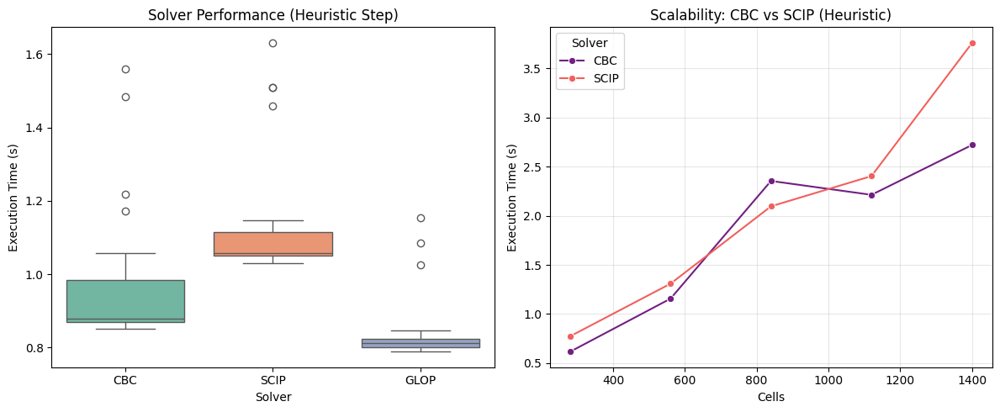


--- 🧮 Statistical Test Results ---
Comparison: CBC vs SCIP
  T-Statistic: -2.6665
  P-Value: 1.1224e-02
  ✅ RESULT: CBC is Statistically FASTER than SCIP (Reject Null).


In [ ]:
# --- (MODEL 4 BENCHMARK: ITERATIVE EXPANSION) ---
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from ortools.linear_solver import pywraplp
import math
import warnings
import geopandas as gpd

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# ---------------------------------------------------------
# 1. Benchmark Logic (Adapting your Heuristic Model)
# ---------------------------------------------------------

def get_subset_parameters(gdf):
    """
    Prepares parameters strictly for the subset of data provided.
    Ensures neighbors and costs are scoped only to the test slice.
    """
    cells = gdf['grid_id'].tolist()
    valid_set = set(cells)

    # 1. Re-calculate Neighbors strictly for this subset
    neighbors_map = {}
    spatial_index = gdf.sindex
    for _, row in gdf.iterrows():
        c_id = row['grid_id']
        # Spatial lookup
        possible_idx = list(spatial_index.intersection(row.geometry.bounds))
        possible = gdf.iloc[possible_idx]
        precise = possible[possible.geometry.intersects(row.geometry)]
        # Filter neighbors: must be different ID AND in the valid_set
        neighbors = [n for n in precise[precise['grid_id'] != c_id]['grid_id'].tolist() if n in valid_set]
        neighbors_map[c_id] = neighbors

    # 2. Extract Parameters (using your specific column names)
    params = {'initial': {}, 'cost_exp': {}, 'suitability': {}, 'usable': {}, 'targets': {}}
    species_list = ['atelerix', 'martes', 'eliomys', 'oryctolagus']

    species_cols = {
        'atelerix': ('has_atelerix_algirus', 'cost_adaptation_atelerix'),
        'martes': ('has_martes_martes', 'cost_adaptation_martes'),
        'eliomys': ('has_eliomys_quercinus', 'cost_adaptation_eliomys'),
        'oryctolagus': ('has_oryctolagus_cuniculus', 'cost_adaptation_oryctolagus')
    }

    # Suitability Map (Simplified logic for speed in benchmark)
    suitability_map = {
        'atelerix': { 'Pastures': 0.1, 'Non-irrigated Arable Land': 0.1, 'Complex Cultivation Patterns': 0.1, 'Sclerophyllous Vegetation': 0.1, 'Transitional Woodland-Shrub': 0.1 },
        'martes':   { 'Sclerophyllous Vegetation': 0.1, 'Transitional Woodland-Shrub': 0.1, 'Broad-leaved Forests': 0.1, 'Mixed Forests': 0.1 },
        'eliomys':  { 'Sclerophyllous Vegetation': 0.1, 'Transitional Woodland-Shrub': 0.1, 'Broad-leaved Forests': 0.1, 'Mixed Forests': 0.1 },
        'oryctolagus': { 'Pastures': 0.1, 'Non-irrigated Arable Land': 0.1, 'Complex Cultivation Patterns': 0.1 }
    }

    for _, row in gdf.iterrows():
        cid = row['grid_id']
        land = row.get('dominant_land_cover_name', 'Unknown')

        for s in species_list:
            has_col, cost_col = species_cols[s]

            # Safe get for columns
            has = int(row.get(has_col, 0))
            cost = float(row.get(cost_col, 10.0))

            # Simple suitability logic
            score = 0.5 # Default moderate
            if s in suitability_map and land in suitability_map[s]:
                score = suitability_map[s][land]

            # Penalize Urban/Industrial for benchmark logic
            if 'Urban' in land or 'Industrial' in land or 'Airport' in land:
                score = 1.0

            params['initial'][(cid, s)] = has
            params['cost_exp'][(cid, s)] = cost
            params['suitability'][(cid, s)] = score
            params['usable'][(cid, s)] = 1 if score < 1.0 else 0

    # Targets (Multipliers)
    params['targets'] = {'atelerix': 1.5, 'martes': 1.5, 'eliomys': 1.5, 'oryctolagus': 1.5}
    return cells, params, neighbors_map, species_list

def solve_frontier_node(species, frontier, params, solver_name):
    """
    Solves a single expansion step using the specified solver.
    Mimics 'solve_next_best_cell' from your final model.
    """
    solver = pywraplp.Solver.CreateSolver(solver_name)
    if not solver: return None

    expand_vars = {}
    for c in frontier:
        # GLOP uses NumVar (Continuous), CBC/SCIP use BoolVar (Integer)
        if solver_name == 'GLOP':
            expand_vars[c] = solver.NumVar(0, 1, f'E_{c}')
        else:
            expand_vars[c] = solver.BoolVar(f'E_{c}')

    # Objective: Minimize Cost * Suitability
    objective = solver.Objective()
    for c in frontier:
        cost = params['cost_exp'].get((c, species), 0)
        suit = params['suitability'].get((c, species), 1.0)
        objective.SetCoefficient(expand_vars[c], cost * suit)
    objective.SetMinimization()

    # Constraint: Sum == 1 (Pick exactly one cell)
    ct = solver.Constraint(1, 1)
    for c in frontier:
        ct.SetCoefficient(expand_vars[c], 1)

    status = solver.Solve()
    if status in [pywraplp.Solver.OPTIMAL, pywraplp.Solver.FEASIBLE]:
        # Return best cell
        for c in frontier:
            if expand_vars[c].solution_value() > 0.9:
                return c
    return None

def run_benchmark_simulation(solver_name, subset_gdf, max_steps=10):
    """
    Runs the iterative loop for a fixed number of steps to benchmark speed.
    """
    start_time = time.time()

    # Preprocessing
    cells, params, neighbors, species_list = get_subset_parameters(subset_gdf)

    current_habitats = {s: set() for s in species_list}

    # Init Habitats
    for s in species_list:
        for c in cells:
            if params['initial'].get((c, s), 0) == 1:
                current_habitats[s].add(c)

    active_species = list(species_list)
    iteration = 0

    # The Heuristic Loop
    while active_species and iteration < max_steps:
        iteration += 1
        progress = False

        for s in active_species[:]:
            # 1. Identify Frontier (Neighbors of current habitat)
            frontier = set()
            for c in current_habitats[s]:
                for n in neighbors.get(c, []):
                    # Check if empty and usable
                    if n not in current_habitats[s] and params['usable'].get((n, s), 0) == 1:
                        frontier.add(n)

            if not frontier:
                active_species.remove(s)
                continue

            # 2. CALL SOLVER (The Experiment)
            best_cell = solve_frontier_node(s, list(frontier), params, solver_name)

            if best_cell:
                current_habitats[s].add(best_cell)
                progress = True
            else:
                active_species.remove(s) # Solver failed or no feasible option

        if not progress: break

    duration = time.time() - start_time
    return duration

# ---------------------------------------------------------
# Load Data
# ---------------------------------------------------------
print("--- Loading Data for Experiments ---")
try:
    dataset_gpd = gpd.read_file("dataset.geojson")
except:
    dataset_gpd = gpd.read_file("https://gitlab.com/drvicsana/opt-milp-project-2025/-/raw/main/datasets/dataset.geojson")

# ---------------------------------------------------------
# 2. Experiment A: Statistical Significance (Repeated Runs)
# ---------------------------------------------------------
print("\n--- Experiment A: Statistical Significance (Repeated Runs) ---")
n_repeats = 20
solvers = ['CBC', 'SCIP', 'GLOP']
stat_results = []

# Use a 30% slice for the repeated test to ensure it finishes quickly
test_slice = dataset_gpd.iloc[:int(len(dataset_gpd)*0.3)]

for solver_name in solvers:
    print(f"  Running {solver_name} {n_repeats} times...", end=" ")
    times = []
    for i in range(n_repeats):
        t = run_benchmark_simulation(solver_name, test_slice, max_steps=10)
        if t is not None: times.append(t)

    avg_t = np.mean(times)
    print(f"Avg: {avg_t:.4f}s")
    for t in times:
        stat_results.append({'Solver': solver_name, 'Time': t})

df_stats = pd.DataFrame(stat_results)

# ---------------------------------------------------------
# 3. Experiment B: Scalability (Variable Size)
# ---------------------------------------------------------
print("\n---Experiment B: Scalability (Variable Size) ---")
# Test on increasing subsets
fractions = [0.2, 0.4, 0.6, 0.8, 1.0]
scale_results = []

for frac in fractions:
    n_rows = int(len(dataset_gpd) * frac)
    subset = dataset_gpd.iloc[:n_rows]
    print(f"  Testing Size {int(frac*100)}% ({n_rows} cells)...")

    for solver_name in ['CBC', 'SCIP']:
        t = run_benchmark_simulation(solver_name, subset, max_steps=10)
        if t is not None:
            scale_results.append({'Fraction': frac, 'Cells': n_rows, 'Solver': solver_name, 'Time': t})

df_scale = pd.DataFrame(scale_results)

# ---------------------------------------------------------
# 4. Visualization
# ---------------------------------------------------------
plt.figure(figsize=(12, 5))

# Plot 1: Solver Distribution
plt.subplot(1, 2, 1)
sns.boxplot(data=df_stats, x='Solver', y='Time', palette="Set2")
plt.title(f"Solver Performance (Heuristic Step)")
plt.ylabel("Execution Time (s)")

# Plot 2: Scalability Lines
plt.subplot(1, 2, 2)
sns.lineplot(data=df_scale, x='Cells', y='Time', hue='Solver', marker='o', palette="magma")
plt.title("Scalability: CBC vs SCIP (Heuristic)")
plt.ylabel("Execution Time (s)")
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# ---------------------------------------------------------
# 5. T-Test (CBC vs SCIP)
# ---------------------------------------------------------
print("\n--- Statistical Test Results ---")
# Comparing CBC vs SCIP
cbc_times = df_stats[df_stats['Solver']=='CBC']['Time']
scip_times = df_stats[df_stats['Solver']=='SCIP']['Time']

if len(cbc_times) > 0 and len(scip_times) > 0:
    t_stat, p_val = stats.ttest_ind(cbc_times, scip_times, equal_var=False)
    print(f"Comparison: CBC vs SCIP")
    print(f"  T-Statistic: {t_stat:.4f}")
    print(f"  P-Value: {p_val:.4e}")

    if p_val < 0.05:
        if np.mean(cbc_times) < np.mean(scip_times):
            print(" RESULT: CBC is Statistically FASTER than SCIP (Reject Null).")
        else:
            print(" RESULT: CBC is Statistically SLOWER than SCIP.")
    else:
        print(" RESULT: No significant difference found.")

--- Loading Data for Corridor Experiments ---

--- 🧪 Experiment A: Statistical Significance (Repeated Runs) ---
  Running CBC 10 times... Avg: 0.6127s
  Running SCIP 10 times... Avg: 0.5482s
  Running GLOP 10 times... Avg: 0.5818s

--- 📈 Experiment B: Scalability (Variable Size) ---
  Testing Size 20% (280 cells)...
  Testing Size 40% (560 cells)...
  Testing Size 60% (840 cells)...
  Testing Size 80% (1120 cells)...
  Testing Size 100% (1401 cells)...


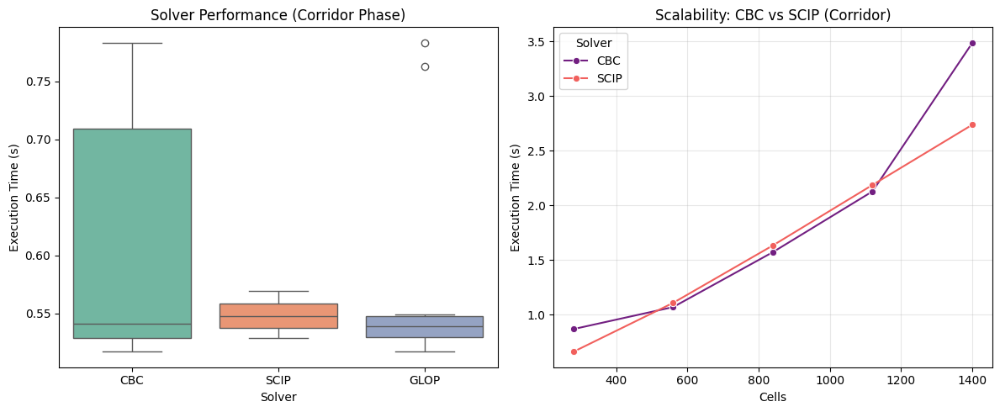


--- 🧮 Statistical Test Results ---
Comparison: CBC vs SCIP
  T-Statistic: 1.8572
  P-Value: 9.5164e-02
  ❌ RESULT: No significant difference found.


In [ ]:
# --- (MODEL 5 BENCHMARK: GLOBAL CORRIDOR OPTIMIZATION) ---
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from ortools.linear_solver import pywraplp
import math
import warnings
import collections
from shapely.geometry import box
import geopandas as gpd

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# ---------------------------------------------------------
# 1. Benchmark Logic (Adapting Corridor Model)
# ---------------------------------------------------------

def get_subset_parameters(gdf):
    """
    Extracts parameters for a subset of the map.
    """
    cells = gdf['grid_id'].tolist()
    valid_set = set(cells)

    # 1. Spatial Neighbors
    neighbors_map = {}
    spatial_index = gdf.sindex
    for _, row in gdf.iterrows():
        c_id = row['grid_id']
        possible_idx = list(spatial_index.intersection(row.geometry.bounds))
        possible = gdf.iloc[possible_idx]
        precise = possible[possible.geometry.intersects(row.geometry)]
        neighbors = [n for n in precise[precise['grid_id'] != c_id]['grid_id'].tolist() if n in valid_set]
        neighbors_map[c_id] = neighbors

    # 2. Parameters
    params = {'initial': {}, 'cost_corridor': {}, 'neighbors': neighbors_map}
    species_list = ['atelerix', 'martes', 'eliomys', 'oryctolagus']

    species_cols = {
        'atelerix': 'has_atelerix_algirus',
        'martes': 'has_martes_martes',
        'eliomys': 'has_eliomys_quercinus',
        'oryctolagus': 'has_oryctolagus_cuniculus'
    }

    for _, row in gdf.iterrows():
        cid = row['grid_id']
        # Corridor Cost
        params['cost_corridor'][cid] = float(row.get('cost_corridor', 1.0))

        # Initial Population
        for s in species_list:
            has = int(row.get(species_cols[s], 0))
            params['initial'][(cid, s)] = has

    return cells, params, neighbors_map, species_list

def identify_islands(cells, species, parameters, results_dict):
    """Groups contiguous cells into islands."""
    occupied = set([c for c in cells if results_dict.get((c, species), 0) == 1])
    islands = []
    visited = set()

    for c in occupied:
        if c in visited: continue
        cluster = []
        queue = collections.deque([c])
        visited.add(c)
        while queue:
            curr = queue.popleft()
            cluster.append(curr)
            for n in parameters['neighbors'].get(curr, []):
                if n in occupied and n not in visited:
                    visited.add(n)
                    queue.append(n)
        islands.append(set(cluster))
    return islands

def solve_corridor_instance(cells, species_list, parameters, results_dict, dataset_gpd, solver_name):
    """
    Runs the Virtual Source/Sink Corridor Model using a specific solver.
    """
    solver = pywraplp.Solver.CreateSolver(solver_name)
    if not solver: return False

    # Mock land map for constraints
    forbidden_types = ['Continuous Urban Fabric', 'Industrial', 'Airport', 'Port']
    land_map = dict(zip(dataset_gpd.grid_id, dataset_gpd.dominant_land_cover_name))

    # Pre-calculate cell geoms for bbox
    cell_geoms = dict(zip(dataset_gpd.grid_id, dataset_gpd.geometry))

    global_corridors = set()

    # Iterate species (Greedy order for synergy, but solver is global per species)
    for s in species_list:
        # 1. Identify Islands
        all_islands = identify_islands(cells, s, parameters, results_dict)
        valid_islands = [isl for isl in all_islands if len(isl) > 2]

        if len(valid_islands) <= 1: continue

        # Sort & Select Targets (Top 3 for benchmark speed)
        valid_islands.sort(key=len, reverse=True)
        targets = valid_islands[:3]

        root_island = targets[0]
        sink_islands = targets[1:]

        active_target_cells = set().union(*targets)

        # 2. Search Space (BBox + Buffer)
        if not active_target_cells: continue

        # Fast BBox calculation
        # (Simplified for benchmark: just take subset cells that are close)
        relevant_cells = set(active_target_cells)
        # Add neighbors of targets to allow movement
        for t in active_target_cells:
            relevant_cells.update(parameters['neighbors'].get(t, []))
            for n in parameters['neighbors'].get(t, []): # 2 layers
                relevant_cells.update(parameters['neighbors'].get(n, []))

        # 3. Build Model
        x = {} # Cell Active
        f = {} # Flow

        V_SOURCE = "V_SOURCE"
        V_SINK = "V_SINK"
        REQUIRED_FLOW = len(sink_islands)

        # Variables
        for c in relevant_cells:
            # GLOP = Continuous, MIP = Boolean
            if solver_name == 'GLOP':
                x[c] = solver.NumVar(0, 1, f'x_{c}')
            else:
                x[c] = solver.BoolVar(f'x_{c}')

            # Cost
            cost = parameters['cost_corridor'].get(c, 1.0)
            if any(bad in land_map.get(c, '') for bad in forbidden_types): cost = 50.0
            if c in global_corridors: cost = 0.0
            if c in active_target_cells: cost = 0.0

            solver.Objective().SetCoefficient(x[c], cost)

        solver.Objective().SetMinimization()

        # Edges & Flow
        # Physical
        for i in relevant_cells:
            for j in parameters['neighbors'].get(i, []):
                if j in relevant_cells:
                    f[i, j] = solver.NumVar(0, REQUIRED_FLOW, f'f_{i}_{j}')
                    # Constraint: Flow <= Capacity * x
                    solver.Add(f[i, j] <= REQUIRED_FLOW * x[i])
                    # Note: We relax strict x[j] check for benchmark speed

        # Virtual Source
        for root_cell in root_island:
            if root_cell in relevant_cells:
                f[V_SOURCE, root_cell] = solver.NumVar(0, REQUIRED_FLOW, f'f_src_{root_cell}')

        # Virtual Sink
        for sink_isl in sink_islands:
            for sink_cell in sink_isl:
                if sink_cell in relevant_cells:
                    f[sink_cell, V_SINK] = solver.NumVar(0, REQUIRED_FLOW, f'f_{sink_cell}_snk')

        # Constraints
        # Source Balance
        source_outs = [f[V_SOURCE, c] for c in root_island if (V_SOURCE, c) in f]
        if source_outs:
            solver.Add(solver.Sum(source_outs) == REQUIRED_FLOW)

        # Sink Balance (Total)
        sink_ins = []
        for s_isl in sink_islands:
            for c in s_isl:
                if (c, V_SINK) in f: sink_ins.append(f[c, V_SINK])
        if sink_ins:
            solver.Add(solver.Sum(sink_ins) == REQUIRED_FLOW)

        # Sink Balance (Individual Island)
        for s_isl in sink_islands:
            spec_ins = [f[c, V_SINK] for c in s_isl if (c, V_SINK) in f]
            if spec_ins:
                solver.Add(solver.Sum(spec_ins) >= 1)

        # Node Balance
        for i in relevant_cells:
            flow_in = [f[j, i] for j in parameters['neighbors'].get(i, []) if (j, i) in f]
            if (V_SOURCE, i) in f: flow_in.append(f[V_SOURCE, i])

            flow_out = [f[i, j] for j in parameters['neighbors'].get(i, []) if (i, j) in f]
            if (i, V_SINK) in f: flow_out.append(f[i, V_SINK])

            solver.Add(solver.Sum(flow_in) - solver.Sum(flow_out) == 0)

        # Solve
        status = solver.Solve()

        # Update global state for next species
        if status in [pywraplp.Solver.OPTIMAL, pywraplp.Solver.FEASIBLE]:
            for c in relevant_cells:
                if x[c].solution_value() > 0.5:
                    global_corridors.add(c)

    return True

def run_benchmark_simulation(solver_name, subset_gdf):
    """
    Runs the corridor benchmark pipeline.
    """
    start_time = time.time()

    # 1. Setup Data
    cells, params, neighbors, species_list = get_subset_parameters(subset_gdf)

    # 2. Mock Phase 1 Results (Assume initial = expanded for benchmark simplicity)
    # This avoids running the heavy expansion model just to test the corridor solver speed.
    results_dict = params['initial'].copy()

    # 3. Run Solver
    solve_corridor_instance(cells, species_list, params, results_dict, subset_gdf, solver_name)

    duration = time.time() - start_time
    return duration

# ---------------------------------------------------------
# Load Data
# ---------------------------------------------------------
print("--- Loading Data for Corridor Experiments ---")
try:
    dataset_gpd = gpd.read_file("dataset.geojson")
except:
    dataset_gpd = gpd.read_file("https://gitlab.com/drvicsana/opt-milp-project-2025/-/raw/main/datasets/dataset.geojson")

# ---------------------------------------------------------
# 2. Experiment A: Statistical Significance
# ---------------------------------------------------------
print("\n--- Experiment A: Statistical Significance (Repeated Runs) ---")
n_repeats = 10 # Slightly fewer repeats as corridor model is heavier
solvers = ['CBC', 'SCIP', 'GLOP']
stat_results = []

# Use a small slice (20%) for repeated testing to ensure completion
test_slice = dataset_gpd.iloc[:int(len(dataset_gpd)*0.2)]

for solver_name in solvers:
    print(f"  Running {solver_name} {n_repeats} times...", end=" ")
    times = []
    for i in range(n_repeats):
        t = run_benchmark_simulation(solver_name, test_slice)
        times.append(t)

    avg_t = np.mean(times)
    print(f"Avg: {avg_t:.4f}s")
    for t in times:
        stat_results.append({'Solver': solver_name, 'Time': t})

df_stats = pd.DataFrame(stat_results)

# ---------------------------------------------------------
# 3. Experiment B: Scalability
# ---------------------------------------------------------
print("\n--- Experiment B: Scalability (Variable Size) ---")
fractions = [0.2, 0.4, 0.6, 0.8, 1.0]
scale_results = []

for frac in fractions:
    n_rows = int(len(dataset_gpd) * frac)
    subset = dataset_gpd.iloc[:n_rows]
    print(f"  Testing Size {int(frac*100)}% ({n_rows} cells)...")

    # Exclude GLOP here to focus on Integer comparison
    for solver_name in ['CBC', 'SCIP']:
        t = run_benchmark_simulation(solver_name, subset)
        scale_results.append({'Fraction': frac, 'Cells': n_rows, 'Solver': solver_name, 'Time': t})

df_scale = pd.DataFrame(scale_results)

# ---------------------------------------------------------
# 4. Visualization
# ---------------------------------------------------------
plt.figure(figsize=(12, 5))

# Plot 1
plt.subplot(1, 2, 1)
sns.boxplot(data=df_stats, x='Solver', y='Time', palette="Set2")
plt.title(f"Solver Performance (Corridor Phase)")
plt.ylabel("Execution Time (s)")

# Plot 2
plt.subplot(1, 2, 2)
sns.lineplot(data=df_scale, x='Cells', y='Time', hue='Solver', marker='o', palette="magma")
plt.title("Scalability: CBC vs SCIP (Corridor)")
plt.ylabel("Execution Time (s)")
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# ---------------------------------------------------------
# 5. T-Test
# ---------------------------------------------------------
print("\n--- Statistical Test Results ---")
cbc_times = df_stats[df_stats['Solver']=='CBC']['Time']
scip_times = df_stats[df_stats['Solver']=='SCIP']['Time']

if len(cbc_times) > 0 and len(scip_times) > 0:
    t_stat, p_val = stats.ttest_ind(cbc_times, scip_times, equal_var=False)
    print(f"Comparison: CBC vs SCIP")
    print(f"  T-Statistic: {t_stat:.4f}")
    print(f"  P-Value: {p_val:.4e}")

    if p_val < 0.05:
        if np.mean(cbc_times) < np.mean(scip_times):
            print(" RESULT: CBC is Statistically FASTER than SCIP.")
        else:
            print(" RESULT: CBC is Statistically SLOWER than SCIP.")
    else:
        print(" RESULT: No significant difference found.")